<h1 align="center"> Tsouros Iakovos Marios </h1>
<h1 align="center"> Computational Electromagnetics and Applications </h1>
<h1 align="center"> Term Project (Microwave Oven)</h1>

---
<h2 align="center"> Assignment </h2>


The goal of this assignment was to create a simulation of a microwave oven, heating a plate of food, using the FDTD method.
The simulation consists of a microwave oven which contains a plate of food, a piece of meat and two potatoes. Dimensions and properties of these objects are presented in the table below:

|     Object    |    Shape    | Radius | Height | $\epsilon_r$ 915Mhz | $\epsilon_r$ 2450MHz | $\sigma$ 915MHz | $\sigma$ 2450MHz |
|:-------------:|:-----------:|:------:|:------:|:-------------------:|:--------------------:|:-------------:|:--------------:|
| Ceramic Plate | Cylindrical |  14cm  |   1cm  |          6          |           6          |   0.001 S/m   |    0.001 S/m   |
|      Meat     | Cylindrical |   8cm  |   2cm  |          55         |          52          |    0.95 S/m   |    1.74 S/m    |
|     Potato    |  Spherical  |   2cm  |    -   |          65         |          54          |    1.02 S/m   |    2.18 S/m    |


Four simulations took place, with the plate located on the floor of the oven. In the initial simulation, the placement of the objects was as in the image below:



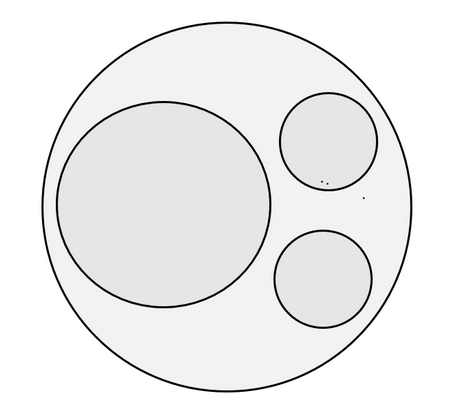
    *Initial Placement of objects in the oven*

The plate was then rotated clockwise by $90^{\circ}$ three times and the mean value of SAR (Specific Absorption Rate) was calculated for each object and for each layout.

<h3> Solution </h3>

> Note: for more information on how to run this notebook see [here](#-Running-this-Notebook-and-project-)

<h4> Simulation Layout </h4>

The dimensions of the simulated oven were chosen as $17cm \times 17cm \times 15cm$  ($L\times W \times H$), and the source is introduced as a rectangle, placed on a side of the oven. The source's dimensions are $6cm \times 5cm$ and its "lower-left" corner is at a height of 9cm and width of 7cm.

*In order to create graphs of the simulation, the program is run once below, with further explanation of how it works following later in the report*

In [1]:
%%capture
from micwave.src.main import run

sar915, snap915, E_snap915, oven915 = run(915);
sar2450, snap2450, E_snap2450, oven2450 = run(2450);


In [74]:


import plotly.graph_objects as go
import numpy as np

from micwave.util.draw_helpers import draw_walls, draw_objects, draw_source, update_layout_grid

fig = go.Figure()
draw_walls(fig)
draw_objects(fig, oven915.obj_indices)
draw_source(fig, oven915.cfg)
update_layout_grid(fig)
fig.show()


In the above figure, the simulation space is presented in its initial state. 

<h4> Implementation details </h4>

The walls used in this simulation are all PEC boundaries and the source follows the equation:

\begin{equation} E^{inc}_y = E_0 sin(\frac{\pi (x - x_0)}{A})cos(\omega t) \end{equation}

where $E_0$ is the power of the source (in this case 117 V/m), $x - x_0$ is the distances from the "lower left" corner of the source and $\omega$ is the angular frequency of the source.

In [73]:
from micwave.util.draw_helpers import draw_source_snap

f = draw_source_snap([oven915.heatmaps, oven2450.heatmaps])
f.show()

SAR was calculated using the following formula:

\begin{equation} SAR = \frac{1}{V} \int \frac{\sigma (r) | E(r) |^2}{\rho (r)}dr \end{equation}

where $\sigma$ is the electrical conductivity of each object, $E$ is the RMS electric field, $\rho$ is the density of each object and $V$ their volume.

In order to obtain a better estimation of the RMS electric field before calculating the SAR, the simulation had to reach a steady state, at which point the amplitude of the electric fields stabilized. This was calculated by measuring the RSS of the electric fields a single voxel over time (figures below) and estimating a timestep after which the amplitude can me considered stable. Measurements over a timestep of 800 (over ~3N periods) were taken into account for the calculation of the RMS electric fields (arbitrarily) as in the absence of a waveguide for the source the electric field never fully stabilized, but after that point it reached a satisfactory stability. The figure below demonstrates the RSS electric fields for a voxel located at grid point (50, 50, 50).

In [46]:
from micwave.util.draw_helpers import draw_steady

f = draw_steady([oven915, oven2450])
f.show()

After the 800-timestep mark, the maximum absolute value of each electric field on every voxel was measured for the remaining duration of the simulation, and the SAR was calculated based on those maximum values for each object. The formula used for the calculation of SAR was:

\begin{equation} SAR = \frac{dx^3 \sigma_{obj}  \sum E^2_{obj}  }{V_{obj} \rho} \end{equation}

where $dx^3$ is the volume of a single voxel and $\sum E^2_{obj}$ is the sum of the squares of the electric fields of the voxels the object occupies.

### Program Layout & 

The program that implements the simulation was written in python, making heavy use of the numpy library. The directory structure is the following:
```
microwave_simulation
│   setup.py
│   file001.txt   
│   file001.txt    
│   file001.txt    
│
└───folder1
│   │   file011.txt
│   │   file012.txt
│   │
│   └───subfolder1
│       │   file111.txt
│       │   file112.txt
│       │   ...
│   
└───folder2
    │   file021.txt
    │   file022.txt
```

<h3> Running this Notebook and project </h3>

---
<h4> Notebook </h4>

<h5> Using Docker </h5>

From the project's root run:
```sh
docker build --tag microwave_tsouros .   # Might require sudo
docker run -p 8888:8888 -t microwave_tsouros  # Port forwarding to a local ip is required to access the nb.
```
From the terminal output, click the link provided by jupyter containing the token:

![jupyter_docker](images/jupyter_run.png)

<h5> Without Docker </h5>

From the project's root run (preferrably in a virtual environment):
```sh
pip install .[pres]
```
When the installation finishes, the notebook can be run with:
```sh
jupyter notebook TsourosReportEM.ipynb
```
***

<h4> Project </h4>

Run the simulation without accessing the notebook. Defaults to 915MHz if no arguments are provided (with the `-f/--frequency` flag).

<h5> Using Docker </h5>

From the project's root run:
```sh
docker build --tag microwave_tsouros .   # Might require sudo
docker run -t microwave_tsouros mic [-f/--frequency 915/2450]
```

<h5> Without Docker </h5>

From the project's root (preferrably in a virtual environment):
```sh
pip install .
mic [-f/--frequency 915/2450]
# OR
python micwave/src/main.py [-f/--frequency 915/2450]
```